In [ ]:
import os
import sys

sys.path.insert(0, os.path.dirname(os.getcwd()) + "/code/")
!pip install helper_functions
!pip install networkx
import networkx
import helper_functions
from importlib import reload

from tqdm import tqdm
import numpy as np
import pandas as pd
from scipy.integrate import quad

import matplotlib.pyplot as plt
%matplotlib inline

import json
import fnmatch
import scipy

from sklearn.metrics import auc
from sklearn.covariance import EllipticEnvelope

  Preparing metadata (setup.py) ... done
  Preparing metadata (setup.py) ... done
  Created wheel for helper_functions: filename=helper_functions-2.0.11-py3-none-any.whl size=7508 sha256=f30658fc6f49fcd48c6ae30929c8c8c924e720e60bdc0817830457e0f8bafb24
  Stored in directory: /root/.cache/pip/wheels/44/50/39/9607453658f3792c33db79e0eff4a8ddad309fe83704244f33
  Created wheel for sklearn: filename=sklearn-0.0.post7-py3-none-any.whl size=2950 sha256=d9f3224305d873a84061329557e059272d765cca6c77133f4940ade76dab9485
  Stored in directory: /root/.cache/pip/wheels/c8/9c/85/72901eb50bc4bc6e3b2629378d172384ea3dfd19759c77fd2c
Successfully built helper_functions sklearn


In [ ]:
from google.colab import drive
drive.mount('/content/drive')

Drive already mounted at /content/drive; to attempt to forcibly remount, call drive.mount("/content/drive", force_remount=True).


In [ ]:
!unzip /content/drive/MyDrive/srp/ambient_dyno_drive_basic_long.zip -d /content/data

Archive:  /content/drive/MyDrive/srp/ambient_dyno_drive_basic_long.zip
replace /content/data/ambient_dyno_drive_basic_long.log? [y]es, [n]o, [A]ll, [N]one, [r]ename: y
  inflating: /content/data/ambient_dyno_drive_basic_long.log  


In [ ]:
# List the files in the 'data' folder
files = [file for file in os.listdir('/content/data') if 'dyno' in file]
files

['ambient_dyno_drive_benign_anomaly.log']

## Load Training Data
 we only have one file, "ambient_dyno_drive_benign_anomaly.log," in the folder, there is no need to perform aggregation since there is no multiple file merging required.

calling out make_can_df

In [ ]:
def make_can_df(log_filepath):

    can_df = pd.read_fwf(
        log_filepath, delimiter = ' '+ '#' + '('+')',
        skiprows = 1,skipfooter=1,
        usecols = [0,2,3],
        dtype = {0:'float64', 1:str, 2: str},
        names = ['time','pid', 'data'] )

    can_df.pid = can_df.pid.apply(lambda x: int(x,16))
    can_df.data = can_df.data.apply(lambda x: x.zfill(16)) #pad with 0s on the left for data with dlc < 8
    can_df.time = can_df.time - can_df.time.min()
    return can_df[can_df.pid<=0x700]

In [ ]:
# Read the log file and parse the contents into a DataFrame
df = make_can_df('/content/data/ambient_dyno_drive_basic_long.log')
df

,time,pid,data
0,0.000000,813,0000042758010000
1,0.001019,1694,0440047E1FC01542
2,0.001020,293,9000401F41BE7960
3,0.002916,737,0000000000000004
4,0.003937,852,1FFF40000003B680
...,...,...,...
2991265,1250.942507,1505,893FE00B0A000080
2991266,1250.942508,1413,0040000000020018
2991267,1250.943525,51,0007A0000E0007D0
2991268,1250.943526,628,00F208F7107C81DD


In [ ]:
# Sort the DataFrame based on the 'time' column
df_sorted = df.sort_values('time')

# Format the 'time' values to two decimal points
df_sorted['time'] = df_sorted['time'].round(2)

# Print the new sorted DataFrame
print(df_sorted)


            time   pid              data
0           0.00   813  0000042758010000
1           0.00  1694  0440047E1FC01542
2           0.00   293  9000401F41BE7960
3           0.00   737  0000000000000004
4           0.00   852  1FFF40000003B680
...          ...   ...               ...
2991265  1250.94  1505  893FE00B0A000080
2991266  1250.94  1413  0040000000020018
2991267  1250.94    51  0007A0000E0007D0
2991268  1250.94   628  00F208F7107C81DD
2991269  1250.94   263  0000000000000000

[2802431 rows x 3 columns]


partition to 10 sec slices / time windows
here, we partition the DataFrame into consecutive time slices of 10 seconds each and print the labeled time slice along with the corresponding rows of data for each time slice.

In [ ]:
# Define the time slice duration in seconds
time_slice_duration = 10.0

# Determine the number of time slices
num_slices = int(df_sorted['time'].max() / time_slice_duration) + 1

# Iterate over the time slices
for i in range(num_slices):
    start_time = i * time_slice_duration
    end_time = (i + 1) * time_slice_duration
    time_slice_label = f"Time Slice {i + 1}: ({start_time}, {end_time}]"
    time_slice_df = df_sorted[(df_sorted['time'] > start_time) & (df_sorted['time'] <= end_time)]
    print(f"{time_slice_label}\n{time_slice_df}\n")


Time Slice 1: (0.0, 10.0]
        time   pid              data
9       0.01  1255  0000001703520000
10      0.01   339  00000004000C0004
12      0.01   661  0000000000000840
13      0.01  1634  4F20000040000000
14      0.01  1668  54D580194147501E
...      ...   ...               ...
23919  10.00   737  0000000000000004
23920  10.00   852  1FF1C0000005A280
23921  10.00  1505  893FE00B0A016480
23922  10.00   354  00080593EA11F4CE
23923  10.00   167  0010FA69512820A0

[22405 rows x 3 columns]

Time Slice 2: (10.0, 20.0]
        time   pid              data
23924  10.01  1255  0000001703520000
23925  10.01   339  00000000000C000A
23927  10.01  1634  4F20000040000000
23928  10.01  1668  54D580194147501E
23929  10.01  1590  24760000EE8A8000
...      ...   ...               ...
47834  20.00   737  0000000000000004
47835  20.00   852  1FE2400000075680
47836  20.00  1505  893FE00B0A00B480
47837  20.00   354  000802D3EA11F4CE
47838  20.00   167  0010FAE9512820A0

[22405 rows x 3 columns]

Time 

### building the graph for each time window

<ipython-input-18-7823aafbc284>:32: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`). Consider using `matplotlib.pyplot.close()`.
  plt.figure(i)


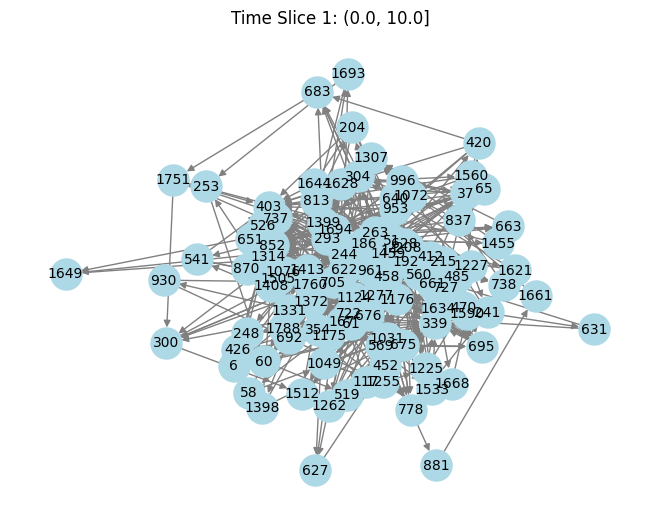

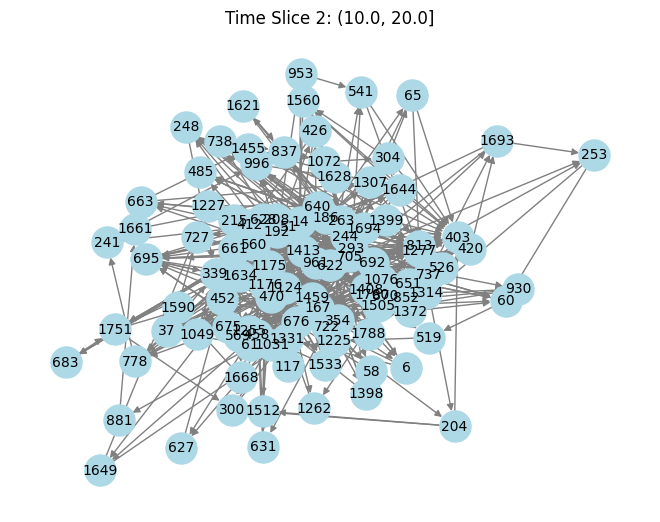

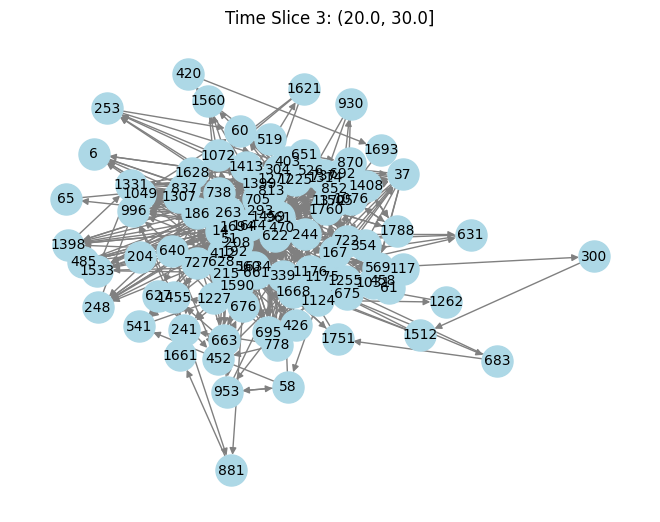

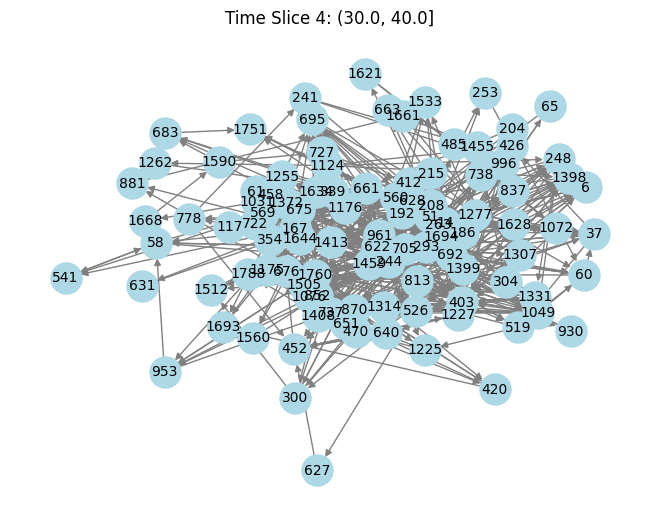

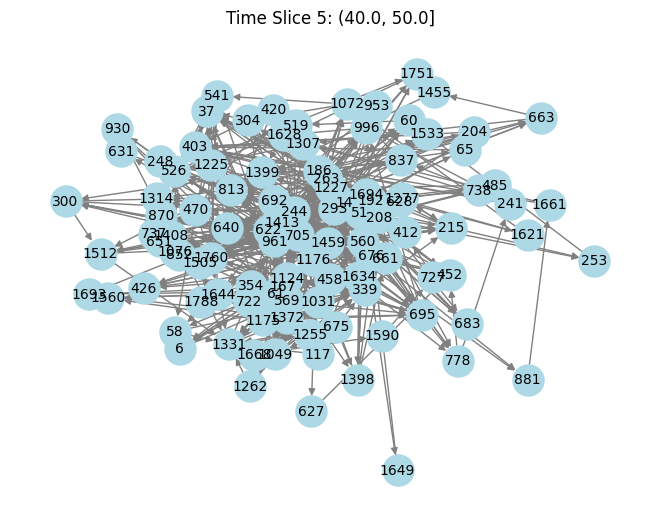

...

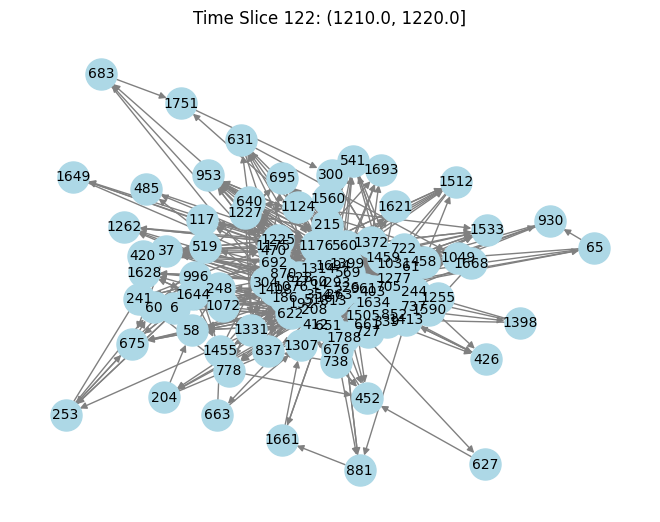

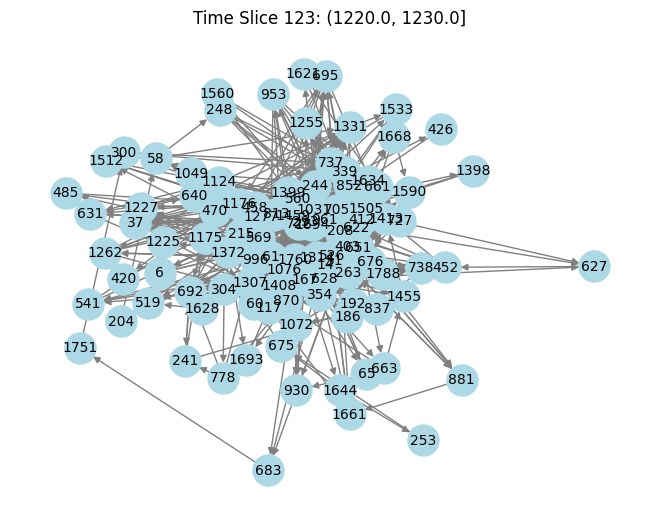

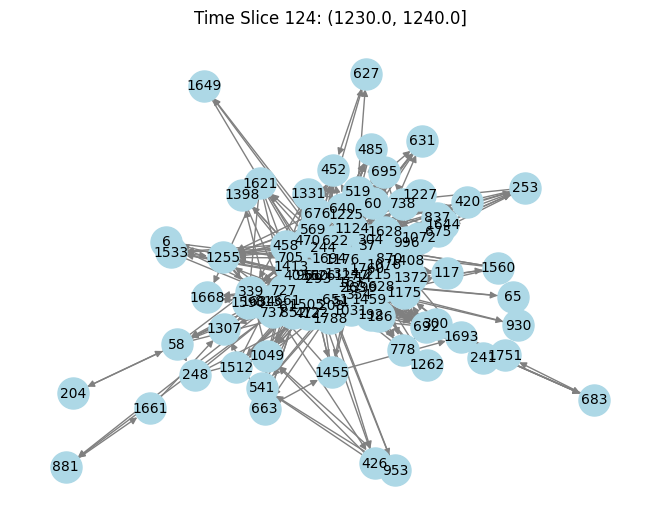

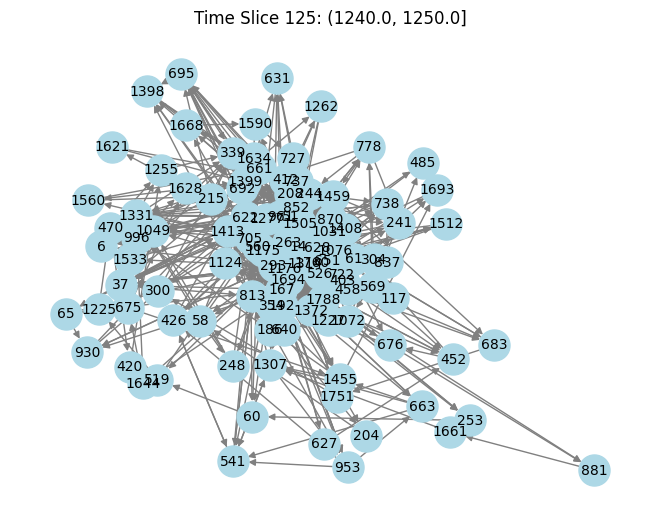

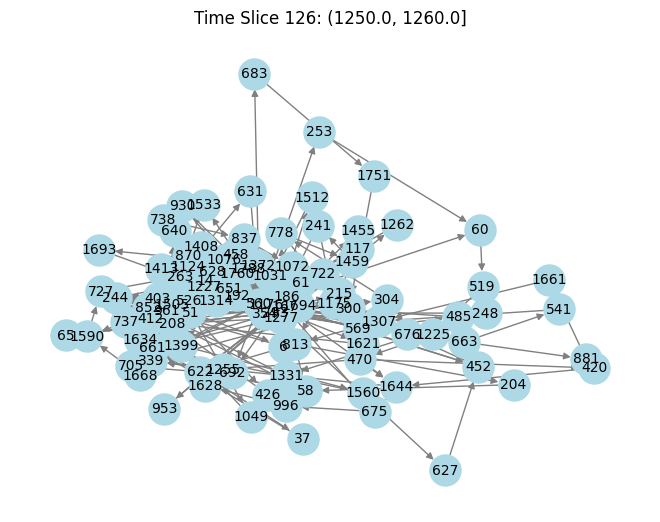

In [ ]:
import networkx as nx
import matplotlib.pyplot as plt

# Define the time slice duration in seconds
time_slice_duration = 10.0

# Determine the number of time slices
num_slices = int(df['time'].max() / time_slice_duration) + 1

# Iterate over the time slices
for i in range(num_slices):
    start_time = i * time_slice_duration
    end_time = (i + 1) * time_slice_duration
    time_slice_label = f"Time Slice {i + 1}: ({start_time}, {end_time}]"
    time_slice_df = df[(df['time'] > start_time) & (df['time'] <= end_time)]

    # Build the graph for the current time slice
    G = nx.DiGraph()
    node_ids = time_slice_df['pid'].unique().tolist()
    G.add_nodes_from(node_ids)

    for j in range(len(time_slice_df) - 1):
        source = time_slice_df.iloc[j]['pid']
        target = time_slice_df.iloc[j+1]['pid']

        if G.has_edge(source, target):
            G[source][target]['weight'] += 1
        else:
            G.add_edge(source, target, weight=1)

    # Plot the graph
    plt.figure(i)
    nx.draw(G, with_labels=True, node_color='lightblue', node_size=500, font_size=10, edge_color='gray')
    plt.title(time_slice_label)

plt.show()
